# Markeplulse Project

#### Predicting change in market direction after Federal Open Market Comission statements

We define *change in market direction* taking the percent change in price from the 20 trading days (approx. 4 weeks) before the statement as the base direction. Then, for each day, we calculate the percent change from the day of the statement until that day. The difference between the change after the statement and beforehand is the *change in market direction*.

The models are fit on the *change in market direction* of every day of the 40 days  (approx. 8 weeks) after satement for every ticker.

##### 1. Imports, load data, and fit models

In [1]:
import pickle
import pandas as pd

from scripts.plots import accuracy_plot, correlation_plot, topic_plot, shap_plot

In [2]:
def load():

    docs = pd.read_parquet('./data/test_statements.parquet')

    prices = pd.read_parquet('./data/prices.parquet')
    prices = prices.loc[docs.index]
    
    with open('./models/tfidf.pkl', 'rb') as f:
        tfidf_model = pickle.load(f)

    with open('./models/transformer.pkl', 'rb') as f:
        transformer_model = pickle.load(f)

    return docs, prices, tfidf_model, transformer_model


try:

    docs, prices, tfidf_model, transformer_model = load()

except FileNotFoundError as e:
    
    print(f'{e.strerror}: {e.filename}')
    !python train.py ./tickers.csv '2008-01-01' '2024-07-01' --model philschmid/bge-base-financial-matryoshka
    docs, prices, tfidf_model, transformer_model = load()

For all of the transformer models we used the `philschmid/bge-base-financial-matryoshka` model. Other models gave similar results as long as they where fine-tuned on financial data.

#### 2. Models

We created two models:

1. A tf-idf model. This model creates six topics form the word frequencies and then fits a linear regression model on these topics to predict the change in market direction.

In [3]:
tfidf_model

Pipeline(steps=[('sentenceselector',
                 SentenceSelector(condition=Exclude voting, email, notes and sentences with less than 15 words,
                                  encoder=philschmid/bge-base-financial-matryoshka,
                                  estimator=KNeighborsRegressor(),
                                  examples=Contains ('the committee decided' & '{x}percent') | 'Federal Reserve Actions',
                                  splitter=Split by line)),
                ('tfidfvectorizer', TfidfVectorizer(max_df=0.5, min_df=0.05)),
                ('nmf', NMF(max_iter=1000, n_components=6, random_state=0)),
                ('linearregression', LinearRegression())])

2. A transformers based model. This model creates embeddings using the sentence transformers library, followed by pca for dimesionality reduction, and then a linear regression model to predict the change in market direction.

In [4]:
transformer_model

Pipeline(steps=[('sentenceselector',
                 SentenceSelector(condition=Exclude voting, email, notes and sentences with less than 15 words,
                                  encoder=philschmid/bge-base-financial-matryoshka,
                                  estimator=KNeighborsRegressor(),
                                  examples=Contains ('the committee decided' & '{x}percent') | 'Federal Reserve Actions',
                                  splitter=Split by line)),
                ('encodertransformer',
                 EncoderTransformer(model_name='philschmid/bge-base-financial-matryoshka')),
                ('pca', PCA(n_components=24)),
                ('linearregression', LinearRegression())])

Much of the text of the FOMC statements is not directly relevant and detracted from model performance. Therefore, as a first step, we created a Sentence Selector which breaks the statement into paragraphs and chooses the most relevant paragraph using hand picked examples of relevant paragraphs. Both models share this step, which uses a transformer model to create embeddings for use in this similarity search.

In [5]:
tfidf_model.named_steps['sentenceselector']

SentenceSelector(condition=Exclude voting, email, notes and sentences with less than 15 words,
                 encoder=philschmid/bge-base-financial-matryoshka,
                 estimator=KNeighborsRegressor(),
                 examples=Contains ('the committee decided' & '{x}percent') | 'Federal Reserve Actions',
                 splitter=Split by line)

Both models use dimensionality reduction. The transformer model uses pca, the standard dimensionality reduction. The tf-df model uses non-negative matrix factoring, which is better at finding topics. Without dimensionality reduction, the models overfit, mostly due to the small data size. 

#### 3. Plots

1. Accuracy plot comparing the balanced accuracy of both models of a prediction of either a positive or negative affect on market direction.

In [6]:
accuracy_plot(docs, prices, {'tfidf':tfidf_model, 'transformer':transformer_model});

: 

2. Correlation plot comparing the pearson correlation of both models. The accuracy is not very high because there are a lot of other factors behind the changes in prices. However, there is a clear correlation for most of the tickers, which indicates that the models are showing true effects of the FOMC statements, even though there are other confounding factors.

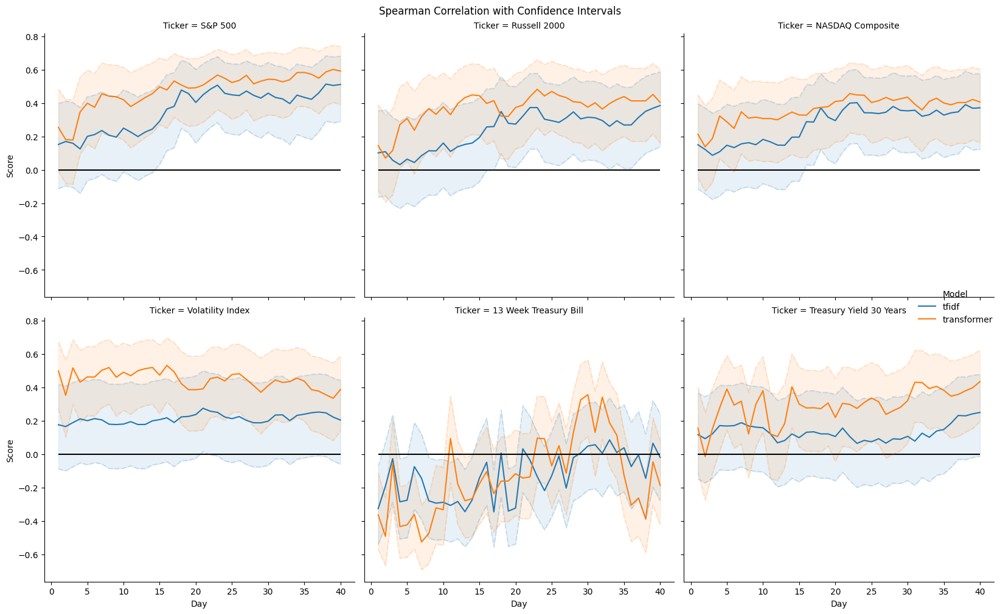

In [ ]:
correlation_plot(docs, prices, {'tfidf':tfidf_model, 'transformer':transformer_model});

From the correlation plot, we can clearly see, at around the 20 day mark, an uptick in the correlations of our predictions with the stock prices of the those tickers that represnt stocks. This seems to indicate that the effects that our model is finding actually relates more to the actual policy mentioned in the statement than to the text of the statement, which is possibly why we get better results after the policy has been implemented for some time.

3. Topic wordclouds. Each topic from the tf-idf model is represented by a wordcloud,. For each ticker, the coefficients for each topic are shown

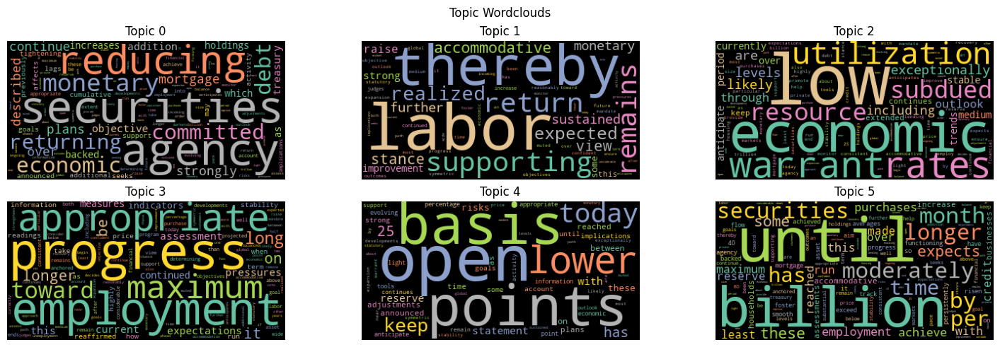

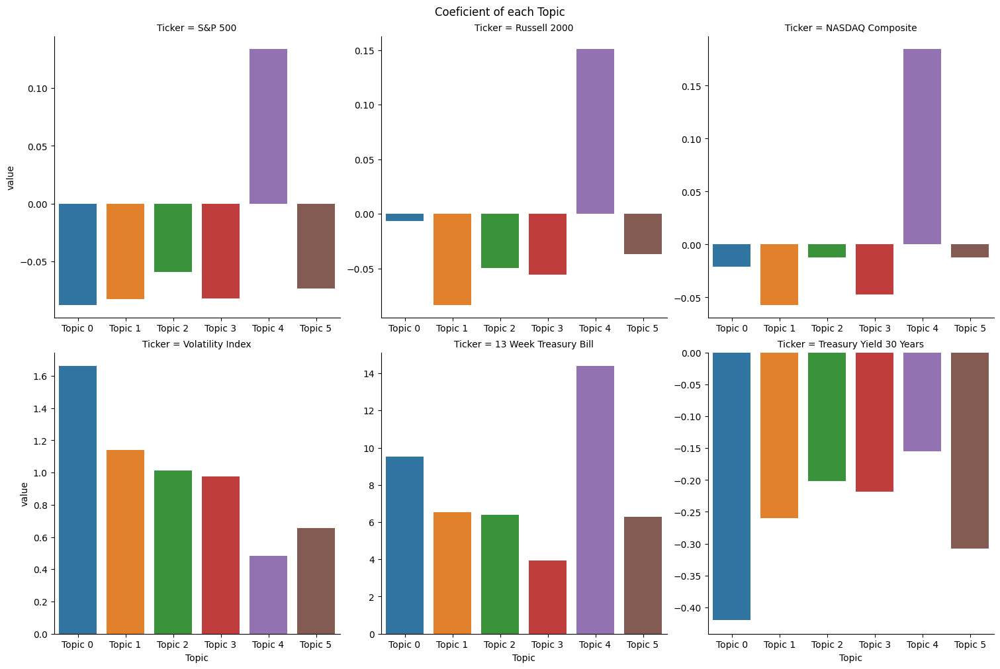

In [ ]:
topic_plot(*tfidf_model[1:], prices);

4. Shap plot. We took 5 random examples from the test data and created a shap plot for each. The shap plots show the impact of each word in the statement on the predictions of the transformer model.

In [ ]:
examples = [
    '2012-12-12',
    '2021-06-16',
    '2009-08-12',
    '2019-03-20',
    '2010-05-09',
]

In [ ]:
shap_plot(transformer_model, docs, prices, examples, 30, '\s');

August 12, 2009


May 09, 2010


December 12, 2012


March 20, 2019


June 16, 2021
